In [1]:
from py_cnmf import *
logging.basicConfig(format="%(relativeCreated)12d [%(filename)s:%(funcName)20s():%(lineno)s] [%(process)d] %(message)s", level=logging.INFO)
%config InlineBackend.figure_format = 'retina'

In [2]:
datadate = '20190902'
t_ = 1       # time subsampling factor
fr = 7.5     # final frame rate after subsampling
ll = 'more_' # name tag when saving files
filepath = '/mnt/sdb1/TwoPhoton/' + datadate + '/'     # path for saving output    
syncpath = '/mnt/sdb1/sync/' + datadate + '/'          # path for rsync to local folders
workpath = '/mnt/ssd/caiman2f/' + datadate +'/'        # storing tmp files in SSD for fast processing, require storage ~ 8 x total tiff size

f_tw = glob.glob(filepath+ '*TW.npy'); print(f_tw); 
TW = np.load(f_tw[-1]); iTemp = int(f_tw[0].split('-')[-1].split('_')[0])
n_p1 = 24  # number of process to use in MC, max = 2*CPUcount
# n_p2 = 3 if np.sum(np.diff(TW,1)) > 102400*t_ else 4 
n_p2 = 8   # number of process for running CNMF

['/mnt/sdb1/TwoPhoton/20190902/5-1_970_92_20620_TW.npy']


In [ ]:
opts = params.CNMFParams(params_dict={
    'fnames': None,
    'fr': fr,
    'decay_time': 1, # for ca6s; set a value smaller than 1 for 6f
    'strides': (72,72), 
    'overlaps': (36,36),
    'max_shifts': (18,18),
    'max_deviation_rigid': 5,    
    'pw_rigid': True,
    'min_mov': 0,
    'p': 0,  # no deconvolution
    'nb': 2, # 2 / 1
    'K':  12,
    'rf': 38,
    'stride': 18,
    'method_init': 'greedy_roi',
    'rolling_sum': True,
    'rolling_length': int(round(15*fr)),
    'only_init': True,
    'gSig': [5, 5],
    'ssub': 1,
    'tsub': 1, # always 1, different from t_
    'check_nan': False,
    'merge_thr': 0.8})

In [ ]:
# opts.data['caiman_version'], '1.8.3'

## get tiff

In [9]:
# stack tiff based on TW
f_tif = sorted(glob.glob(workpath + '*.tif'))
nfr = np.load(filepath+'nfr.npy'); snfr = np.insert(np.cumsum(nfr),0,0)
i=0; n=0; m=[]; tot = np.sum(np.diff(TW,1)) 
sub = np.ceil(tot/np.ceil(tot/4000)).astype(int) # at most 4000 frame per file, ~ 2GB
while sub%t_ != 0: sub+=1 
for tw in TW:
    m_ = []; i = np.where(snfr>tw[0])[0][0]; t0 = tw[0]
    while tw[1]- t0 > 0:
        t_key = range(t0 - snfr[i-1], min(tw[1]-snfr[i-1], nfr[i-1]))
        m_.extend(tifffile.imread(f_tif[i-1], key=t_key).reshape(-1,512,512))
        t0 += len(t_key); i+=1 
    while len(m_)>0:
        lava = sub - len(m); m.extend(m_[:lava]); m_[:lava] = []
        if len(m)==sub:
            fname = workpath+'_'+str(0)*((n<100)+(n<10))+str(n)+'_'+str(tot)+'_'+str(len(m))+'_n.tif'
            tifffile.imsave(fname, np.array(m)); n+=1; m=[]
while len(m)%t_ != 0: m[-1:] = []
if len(m)>0: tifffile.imsave(workpath+'_'+str(0)*((n<100)+(n<10))+str(n)+'_'+str(tot)+'_'+str(len(m))+'_n.tif', np.array(m))    
print(n) # number of tiffs

5


## motion correction

In [ ]:
fnames = sorted(glob.glob(workpath + '*n.tif'))

if 'dview' in locals(): cm.stop_server(dview=dview)
c, dview, n_processes = cm.cluster.setup_cluster(backend='local', n_processes=n_p1, single_thread=False)

# run non-rigid mc on iTemp-th tiff to get template
mc0 = MotionCorrect([fnames[iTemp]], dview=dview, **opts.get_group('motion'))
mc0.motion_correct(); template = mc0.total_template_els
np.save(filepath +ll+ 'template', template)     

# run non-rigid mc on all data wrt the template
mc = MotionCorrect(fnames, dview=dview, **opts.get_group('motion'))
mc.motion_correct(template=template, save_movie=True)
cm.stop_server(dview=dview)

shifts = np.stack((np.mean(mc.x_shifts_els,1),np.mean(mc.y_shifts_els,1)),0)
np.save(filepath +ll+ 'shifts' , shifts)
xs, ys = np.load(filepath +ll+ 'shifts.npy')
np.save(filepath +ll+ 'sls', [getSlice(xs), getSlice(ys)])
deleteFiles(workpath + '*.tif')

In [ ]:
# calculate correlation with template for each frame
fnames = mc.mmap_file; lf=len(fnames); tmpl = template.flatten(order='F')
sls_ = [getSlice(shifts[0,snfr[iTemp]:snfr[iTemp+1]], [50,1.5]), getSlice(shifts[1,snfr[iTemp]:snfr[iTemp+1]], [50,1.5])]
CaS=[]; cor=[]; ys=[]; shs = []; ii=0; n0=int(round(fr*t_)); span=10
for l in range(lf):
    Yr, dims, T = cm.load_memmap(fnames[l])
    CaS.append(np.mean(Yr,1).reshape(dims, order='F'))
    for t in range(T):
        ys.append(Yr[:,t]); shs.append(shifts[:,ii]); ii+=1
        if len(shs)%(span*n0)==0:
            mask = getMask(shs,sls_); cor.append(pearsonr(np.mean(ys,0)[mask], tmpl[mask])[0]); ys[:n0]=[]; shs[:n0]=[]
tRc = np.arange(len(cor))*n0 + (n0*span-1)/2
f = interpolate.interp1d(tRc, cor, kind='quadratic', bounds_error=False, fill_value=(cor[0],cor[-1]))
np.save(filepath +ll+ 'cor', f(np.arange(ii)))   # smoothed correlation with template
np.save(filepath +ll+ 'CaS', CaS)                # chunk-averaged mean images
tifffile.imsave(syncpath + 'cas_.tif', np.array(CaS))
CaC = np.zeros((lf,lf)); v_m = np.percentile(CaS,99)
for i in range(lf):
    for j in range(i,lf): 
        CaC[i,j] = pearsonr(CaS[i].flatten(), CaS[j].flatten())[0]; CaC[j,i] = CaC[i,j]
np.save(filepath  +ll+ str(iTemp) + '_CaC', CaC)

In [6]:
xys = np.load(filepath +ll+ 'shifts.npy').T; cor = np.load(filepath +ll+ 'cor.npy')
CaC = np.load(glob.glob(filepath +ll+ '*CaC.npy')[-1])
tot=len(xys); nseg = int(np.ceil(tot/4000)); step = int(np.ceil(tot/nseg)); print(nseg,step,tot)
sls = np.load(filepath +ll+ 'sls.npy', allow_pickle=True).tolist(); print(sls) # a mask for edge

6 3437 20620
[slice(3, 510, None), slice(2, 510, None)]


#### Plot xy shift and correlation, the result should look stable in this stage

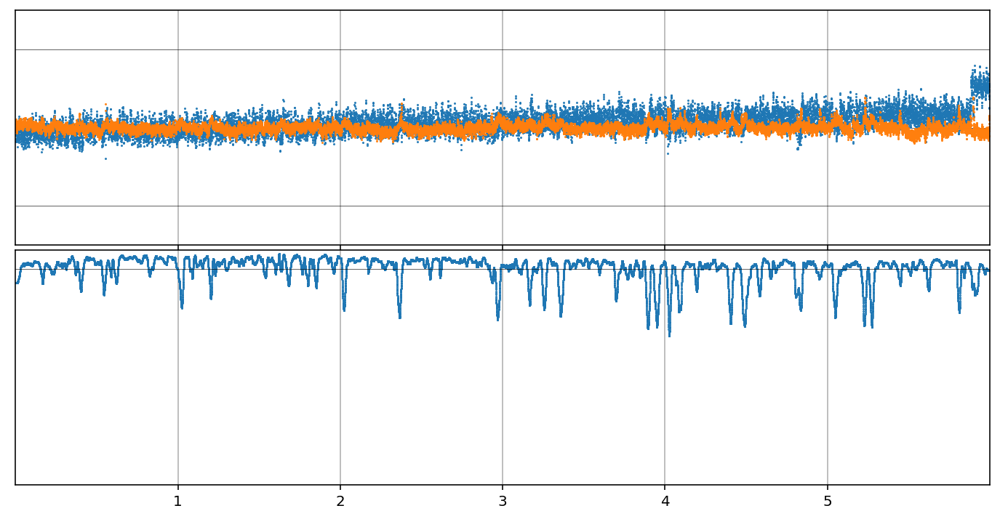

In [356]:
pf(nseg*2,6); gs = gridspec.GridSpec(2,1); gs.update(hspace=0.02); plt.subplot(gs[0])
for hh in [-10,0,10]: plt.axhline(hh,lw=.3,c='k'); 
plt.plot(xys,'.',ms=1); plt.xticks(np.arange(1,nseg)*step, [])
plt.grid(True); plt.xlim(0,tot); plt.yticks([],[]);  plt.ylim(-15,15)
plt.subplot(gs[1])
plt.plot(cor,'.',ms=1); plt.axhline(np.mean(cor),lw=.3,c='k'); plt.grid(True)
plt.xlim(0,tot); plt.yticks([],[]); plt.xticks(np.arange(1,nseg)*step,np.arange(1,nseg)); plt.ylim(bottom=0.6);

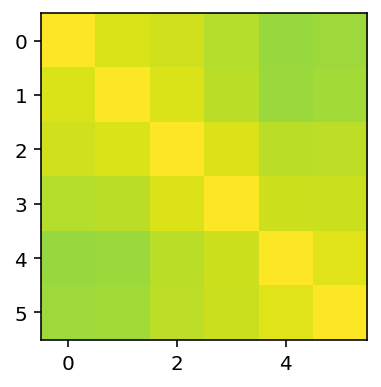

In [22]:
lf = len(CaC); pf(lf/3+1,lf/3+1); plt.imshow(CaC, cmap='viridis', vmin=.9, vmax=1);

# CNMF

In [24]:
# some standard cnmf procedure
if 'dview' in locals(): cm.stop_server(dview=dview)
c, dview, n_processes = cm.cluster.setup_cluster(backend='local', n_processes=n_p2, single_thread=False)
fname_parts = cm.save_memmap_each(fnames, base_name='mc_'+ll, order='C', resize_fact=(1,1,1/t_), dview=dview)
[os.remove(f) for f in fnames];
fname_new = cm.save_memmap(fname_parts, base_name= 'mc_'+ll, order='C', dview=dview)
[os.remove(f) for f in fname_parts];

     4689337 [cluster.py:         stop_server():358] [24207] stop_cluster(): done
     4733282 [mmapping.py:    save_memmap_join():201] [24207] Memmap file for fname_tot: /mnt/ssd/caiman2f/20190902/mc_more__d1_512_d2_512_d3_1_order_C_frames_20620_.mmap
     4741742 [mmapping.py:    save_memmap_join():228] [24207] Deleting big mov


In [4]:
fname_new = sorted(glob.glob(workpath + '*.mmap'))[-1]; print(fname_new)
Yr, dims, T = cm.load_memmap(fname_new)
images = np.reshape(Yr.T, [T] + list(dims), order='F') 
sls = np.load(filepath +ll+ 'sls.npy', allow_pickle=True).tolist()
if not os.path.exists(filepath +ll+ 'Cn.npy'):
    np.save(filepath +ll+ 'Cn', cm.local_correlations(images[:51000].transpose(1,2,0)))

/mnt/ssd/caiman2f/20190902/mc_more__d1_512_d2_512_d3_1_order_C_frames_20620_.mmap


## 1st run

In [ ]:
if 'dview' in locals(): cm.stop_server(dview=dview)
c, dview, n_processes = cm.cluster.setup_cluster(backend='local', n_processes=n_p2, single_thread=False)
cnm0 = cnmf.CNMF(n_processes, params=opts, dview=dview)
cnm0 = cnm0.fit(images, indices=sls)
cnm = cnm0.refit(images, dview=dview)

In [ ]:
# a custom function to evaluate component, output is savd inside cnm
evaComp(cnm, Yr, np.insert(np.cumsum(np.diff(TW,1)),0,0)/t_, use_CNN=1)
cnm.save(filepath +ll+ 'cnm0.hdf5')
cm.stop_server(dview=dview)
# cnm = cnmf.load_CNMF(filepath +ll+ 'cnm0.hdf5');
cnm.estimates.coordinates = get_contours(cnm.estimates.A, cnm.dims, thr_method='nrg', thr='0.98')

In [9]:
try: Cn = np.load(filepath +ll+ 'Cn.npy')
except: Cn = np.load(filepath +ll+ 'template.npy')
CaS = np.load(filepath +ll+ 'CaS.npy'); Ca = np.mean(CaS,0)
aligns = np.load(filepath + 'aligns.npy')/t_

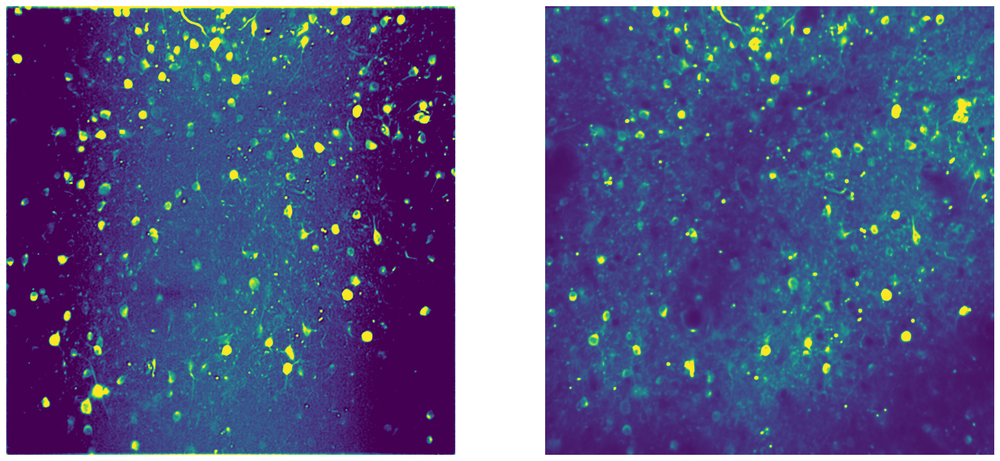

In [11]:
pf(20,9.5) # plot local correlation image and average image
plt.subplot(121); plt.imshow(Cn, cmap='viridis', vmin=np.percentile(Cn,30), vmax=np.percentile(Cn,98)); plt.axis('off');
plt.subplot(122); plt.imshow(Ca, cmap='viridis', vmin=0, vmax=np.percentile(Ca,99)); plt.axis('off')
plt.savefig(syncpath + 'Ca.png', bbox_inches='tight', dpi=150)

-0.201981397327106 0.18885411917374997


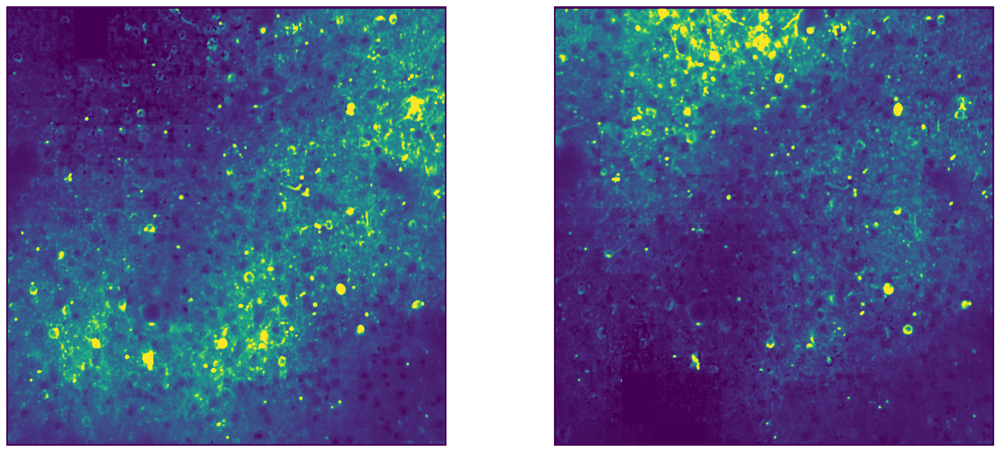

In [88]:
pBG(cnm) # plot background component
if len(cnm.estimates.f)>1: # reduce nb if correlation is too large
    print(pearsonr(cnm.estimates.f[0],cnm.estimates.f[1])[0], pearsonr(cnm.estimates.b[:,0],cnm.estimates.b[:,1])[0])

## filter components

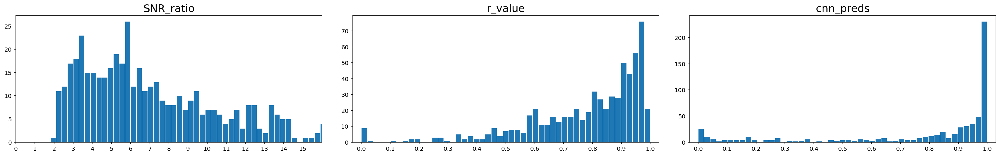

In [53]:
pMetric(cnm)

In [17]:
vals = [4.5, .65,  7.5, .85] # lower bound on SNR, lower bound on r_value and collective bounds 
bad = (cnm.estimates.SNR_comp < vals[0]) + (cnm.estimates.r_values < vals[1]) + (cnm.estimates.SNR_comp < vals[2]) * (cnm.estimates.r_values < vals[3])
idxs = np.arange(cnm.estimates.nr); cnm.estimates.idx_components_bad = idxs[bad]; cnm.estimates.idx_components = idxs[~bad]
print(len(cnm.estimates.idx_components), len(cnm.estimates.idx_components_bad))

364 280


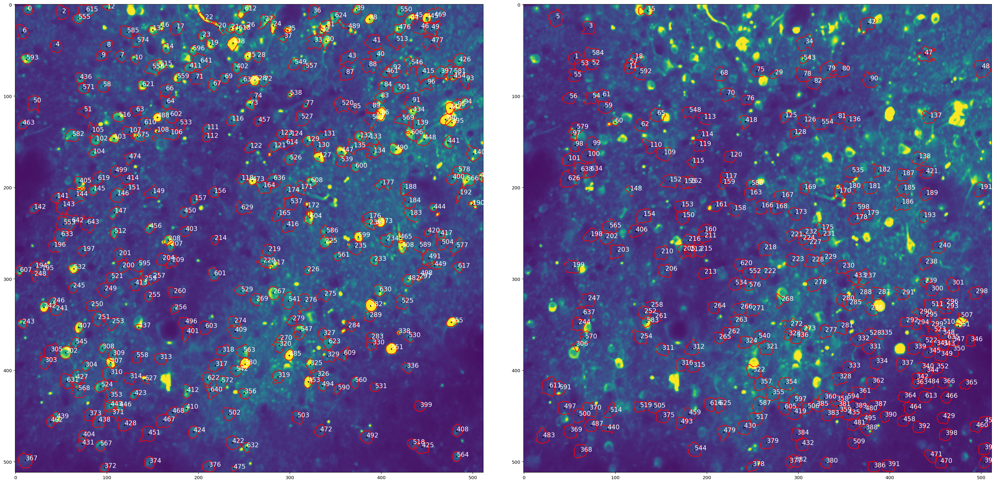

In [18]:
pCompCont(cnm, Ca) # plot good vs bad components, bad ones will be discarded
Ct = getCt(cnm, Ca, filepath) # get the reference image with component contour overlaid on Ca

In [ ]:
# check some components whose r_values can not be evaluated
for n0 in np.where(cnm.estimates.r_values==0)[0]: pComp(cnm, Ct, Cn, n0, aligns, 0, 0)

In [27]:
cnm,_,_ = saveComp(cnm, [583]) # save some nice components if any

365 279


## 2nd run

In [ ]:
if 'dview' in locals(): cm.stop_server(dview=dview)
c, dview, n_processes = cm.cluster.setup_cluster(backend='local', n_processes=int(1.6+(.64*n_p2)**2), single_thread=False)
cnm2 = cnm.refit(images, dview=dview)
evaComp(cnm2, Yr, np.insert(np.cumsum(np.diff(TW,1)), 0, 0)/t_, sls, use_CNN=1)
cnm2.save(filepath +ll+ 'cnm2.hdf5')
cm.stop_server(dview=dview)

In [ ]:
cnm2 = cnmf.load_CNMF(filepath +ll+ 'cnm2.hdf5');
cnm2.estimates.coordinates = get_contours(cnm2.estimates.A, cnm2.dims, thr_method='max', thr='0.2')

-0.6564060388628246 0.08297473854218196


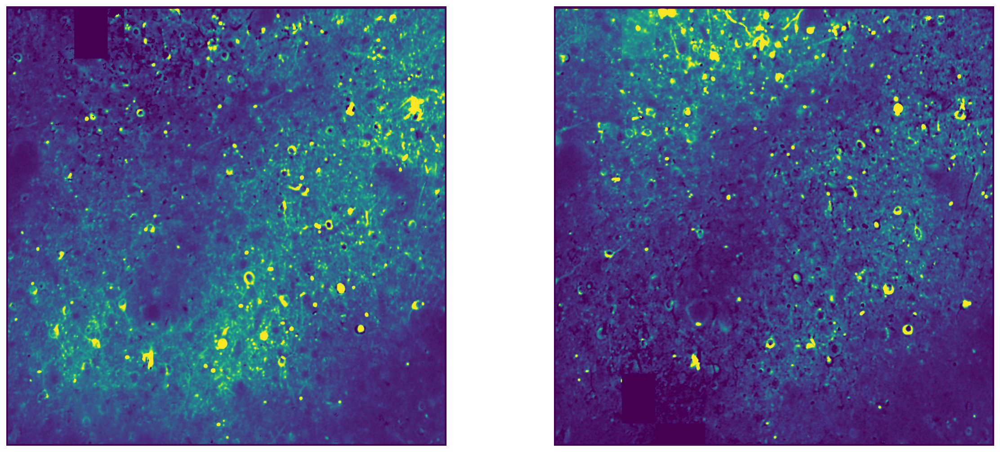

In [30]:
pBG(cnm2)
if len(cnm2.estimates.f)>1: print(pearsonr(cnm2.estimates.f[0],cnm2.estimates.f[1])[0], pearsonr(cnm2.estimates.b[:,0],cnm2.estimates.b[:,1])[0])

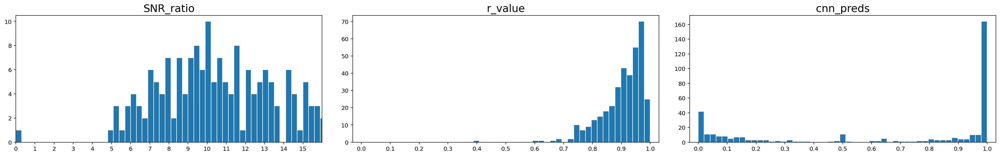

In [54]:
pMetric(cnm2)

### Group component into good, bad and todo

In [61]:
val_ = [5.5, .7, .01] # lower bound for each metric
vals = [val_, 8, 12, .8, .95, .6, .998] 
# the last six values use the original evaluation design of caiman
# components fulfilling the criteria went to c_good group
# other components is then grouped into todo and bad
c_todo, c_good = idxComp(cnm2, vals) 
# todo / good / bad

112 185 180


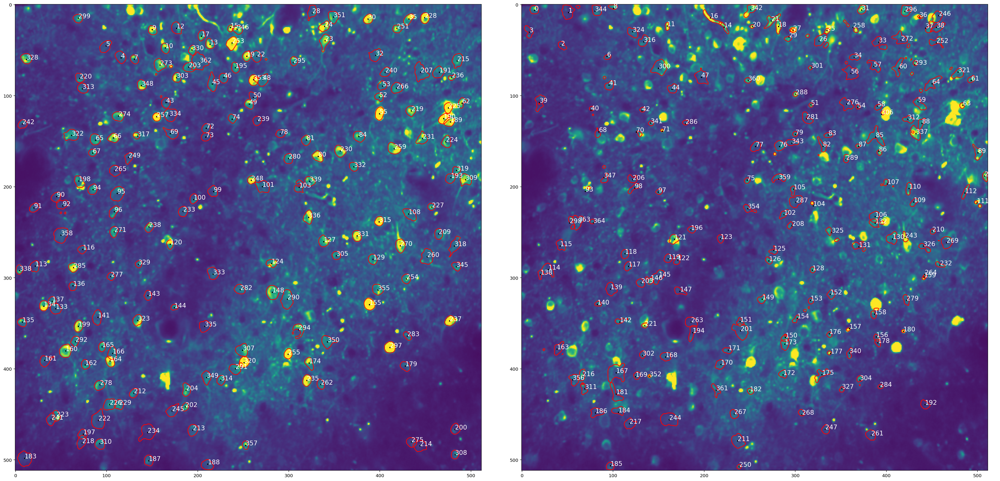

In [62]:
pCompCont(cnm2, Ca); Ct = getCt(cnm2, Ca, filepath)
# good vs. bad

In [63]:
# check some units whose r_values can not be evaluated
for n0 in np.where(cnm2.estimates.r_values==0)[0]: pComp(cnm2, Ct, Cn, n0, aligns, 0, 0)

In [64]:
c_nice = [] # save some nice units if any
if len(c_nice)>0: c_todo = np.union1d(c_todo, c_nice)

10 - 10 [ 47 164 ]  0.96, 75.46, 1.0000


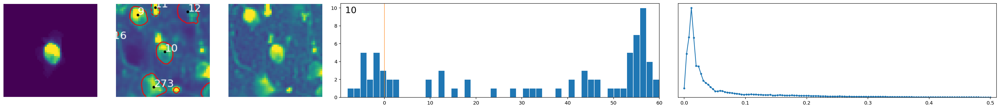

In [92]:
# an illustration of pComp function
n0=10; pComp(cnm2, Ct, Cn, n0, aligns, 0, 0)
# values: n0 - neuron id, [x,y coordinates], SNR_ratio, r_value, cnn_pred
# left 3: single component image, cropped average image with contour, cropped correlation image 
# middle: distribution of calcium signal peaks
# right: power spectral density used to estimate SNR_ratio

### remove correlated component in todo

In [66]:
trace0 = cnm2.estimates.C; _, traced = deTrend(trace0, fr); _, tracep = noiseNormalization(traced, fr)

In [72]:
c_check = list(set(list(c_todo) + list(c_good))); lcc = len(c_check); cCor = np.zeros((lcc,lcc))
for i in range(lcc):
    for j in range(i+1,lcc):
        cCor[i,j] = pearsonr(traced[c_check[i]], traced[c_check[j]])[0]

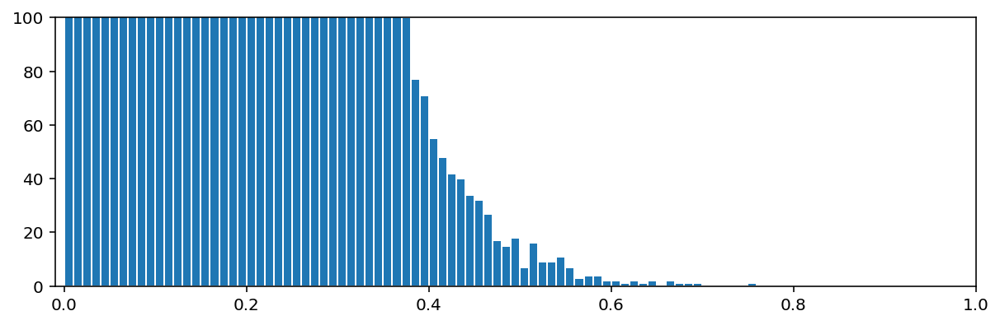

In [361]:
# plot the distribution of component correlation, values should fall below 'merge_thr'
pf(10,3); plt.hist(cCor.ravel(), bins=np.arange(0,100)*0.01, ec='w'); plt.ylim(0,100); plt.xlim(-0.01,1);

In [77]:
c1, c2 = np.where(cCor>.3) # check the pairs with correlation higher than 0.3
Ct = getCt(cnm2, Ca, filepath, [c_good, c_todo]) # get reference image with contour of good and todo components (dashed: todo)
ic=0; c_bad=[] # c_bad holds id for bad component

In [ ]:
# a semi-automatic procedure to remove correlated component, run this until ic>len(c1)
while True:
    n1 = c_check[c1[ic]]; n2 = c_check[c2[ic]]; ic+=1
    while np.sqrt(sum((cnm2.estimates.coordinates[n1]['CoM'] - cnm2.estimates.coordinates[n2]['CoM'])**2))>4*cnm2.params.init['gSig'][0] or (n1 in c_bad) or (n2 in c_bad):
        # only check for area no more than 4*gSig away
        n1 = c_check[c1[ic]]; n2 = c_check[c2[ic]]; ic+=1
    if   (n1 in c_good) and (n2 in c_todo) and (cnm2.estimates.cnn_preds[n2]<.4): c_bad.append(n2)
    elif (n2 in c_good) and (n1 in c_todo) and (cnm2.estimates.cnn_preds[n1]<.4): c_bad.append(n1)
    else: break # cannot assign automaticly, break for human inspection
print(np.round(cCor[c1[ic-1],c2[ic-1]],3)) # print the correlation value between the pairs
pComp(cnm2, Ct, Cn, n1, aligns, 0,0); pComp(cnm2, Ct, Cn, n2, aligns, 0,0) # plot component information for comparison

0.327
150 - 150 [ 365 289 ]  0.89, 9.66, 0.8728


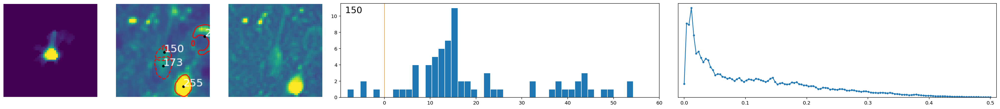

173 - 173 [ 373 289 ]  0.87, 11.46, 0.7385


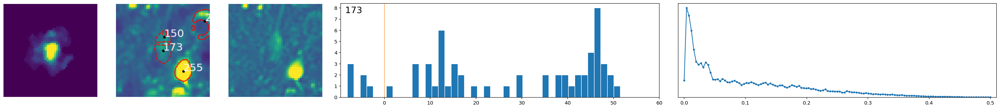

In [99]:
# example result

In [113]:
# run this cell if the first component is bad, then go back to the while loop
c_bad.append(n1); print(c_bad)

[6, 29, 26, 252, 68, 82, 88, 112, 138, 126, 131, 150, 175, 176, 181, 184, 311, 221, 229, 232, 298, 312]


In [108]:
# run this cell if the second component is bad, then go back to the while loop
c_bad.append(n2); print(c_bad)

[6, 29, 26, 252, 68, 82, 88, 112, 138, 126, 131, 150, 175, 176, 181, 184, 311, 221, 229]


In [ ]:
# if both is good, the just run the to the while loop again

In [ ]:
for n0 in c_bad: pComp(cnm2, Ct, Cn, n0, aligns, 0, 0) # check all the bad component

In [122]:
c_nice = []; c_bad = np.setdiff1d(c_bad, c_nice) # save some component from bad if any
c_todo = np.setdiff1d(c_todo, c_bad); c_good = np.setdiff1d(c_good, c_bad); Ct = getCt(cnm2, Ca, filepath, [c_good, c_todo])

In [122]:
print(c_todo.tolist()); c_bad0=[]; i=0

[0, 1, 3, 11, 14, 18, 21, 25, 27, 31, 33, 34, 37, 38, 39, 41, 44, 47, 57, 58, 60, 61, 64, 76, 79, 83, 85, 89, 97, 98, 102, 106, 107, 109, 110, 115, 117, 118, 121, 122, 125, 128, 132, 140, 145, 146, 147, 149, 151, 152, 156, 167, 169, 170, 173, 182, 185, 186, 194, 205, 206, 208, 210, 211, 216, 244, 247, 250, 256, 261, 268, 272, 276, 279, 281, 288, 296, 302, 304, 316, 324, 327, 337, 342, 343, 344, 354, 359, 360, 364]


### check c_todo one by one, perform quick rejection

In [ ]:
# skip this steps if not experienced

364 - 364 [ 240 78 ]  0.91, 9.72, 0.0119


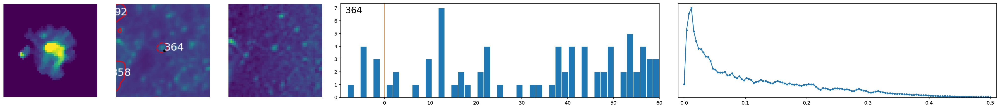

In [256]:
n0 = c_todo[i]; i+=1; pComp(cnm2, Ct, Cn, n0, aligns, 0, 0)

In [ ]:
c_bad0.append(n0); print(c_bad0)

[3, 11, 14, 21, 25, 33, 37, 39, 57, 58, 60, 61, 64, 85, 89, 97, 98, 102, 107, 109, 110, 115, 122, 125, 128, 147, 151, 152, 167, 169, 250, 268, 272, 288, 302, 327, 354, 364]


### final rescue (select component in todo for adding to good)

In [260]:
c_save0 = np.setdiff1d(c_todo, c_bad0); Ct = getCt(cnm2, Ca, filepath, [c_good, c_save0])
print(c_save0.tolist()); c_save=[]; i=0

[0, 1, 18, 27, 31, 34, 38, 41, 44, 47, 76, 79, 83, 106, 117, 118, 121, 132, 140, 145, 146, 149, 156, 170, 173, 182, 185, 186, 194, 205, 206, 208, 210, 211, 216, 244, 247, 256, 261, 276, 279, 281, 296, 304, 316, 324, 337, 342, 343, 344, 359, 360]


117 - 117 [ 287 117 ]  0.88, 10.08, 0.9496


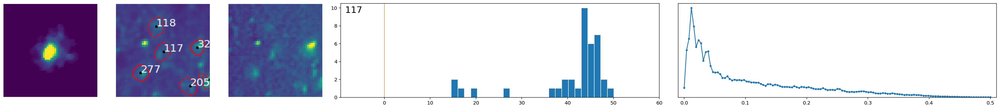

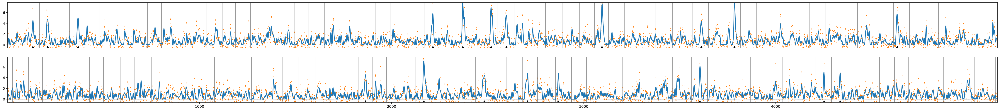

117 - 117 [ 287 117 ]  0.88, 10.08, 0.9496


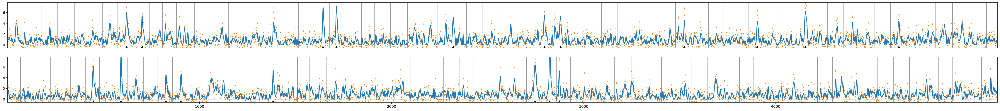

In [286]:
# example output, calcium trace is plotted for reference
# could plot traces for good components first, to get a feeling for what should be good

In [ ]:
n0 = c_save0[i]; i+=1
pComp(cnm2, Ct, Cn, n0, aligns, 0, 1); pComp(cnm2, Ct, Cn, n0, aligns, 0, 2)

In [347]:
# add to c_save if n0 is good, then run the above cell again
c_save.append(n0); print(c_save)

[0, 18, 31, 34, 38, 44, 76, 79, 83, 117, 118, 121, 145, 146, 149, 156, 182, 185, 186, 205, 210, 211, 216, 244, 247, 256, 276, 279, 281, 296, 304, 316, 337, 342, 344]


In [351]:
c_diss=[]; cnm2.estimates.idx_components = np.union1d(c_save, c_good)
if len(c_diss)>0: cnm2.estimates.idx_components = np.setdiff1d(cnm2.estimates.idx_components, c_diss)
cnm2.estimates.idx_components_bad = np.setdiff1d(np.arange(cnm2.estimates.nr), cnm2.estimates.idx_components)
print(len(cnm2.estimates.idx_components), len(cnm2.estimates.idx_components_bad))

219 146


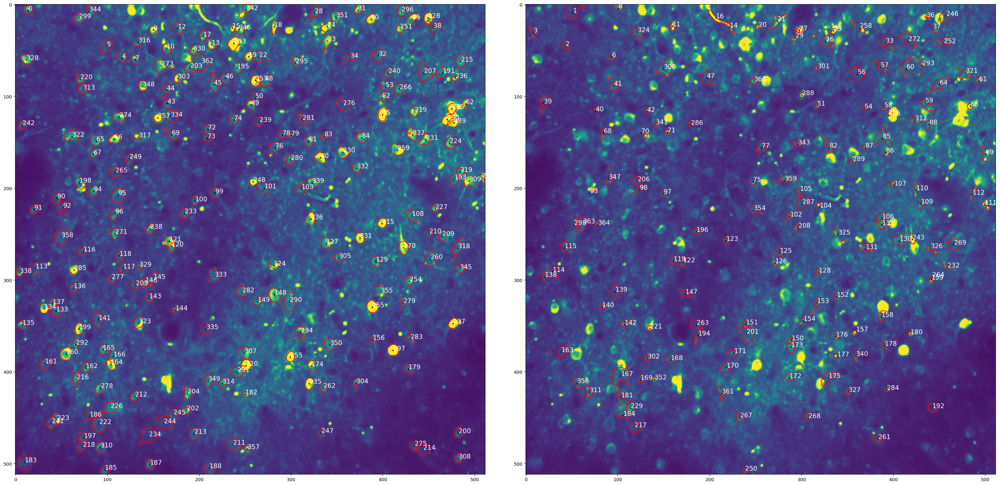

In [352]:
pCompCont(cnm2, Ca) # plot good vs. bad
plt.savefig(syncpath + 'plotCont.png', bbox_inches='tight', dpi=150); Ct = getCt(cnm2, Ca, filepath)

In [362]:
cnm2.save(filepath +ll+ 'cnm2.hdf5'); np.save(filepath +ll+ 'vals', vals)
Fb = (cnm2.estimates.C + cnm2.estimates.YrA + (cnm2.estimates.A.T@cnm2.estimates.b)@cnm2.estimates.f)[cnm2.estimates.idx_components]
mode, Fbd = deTrend(Fb, fr); Fn, _ = noiseNormalization(Fbd, fr)
# normalized by the noise variance, the variance of the residual signal after subtracting a Savitzky-Golay filtered version

mat = dict({  'F': Fb,
             'F_': Fn,
            'idx': cnm2.estimates.idx_components,
            'CoM': np.array([co['CoM'] for co in cnm2.estimates.coordinates])[cnm2.estimates.idx_components], 
            'fr' : fr,
         'cue_on': aligns})          
sio.savemat('/mnt/sdb1/mats/demo_'+datadate+'.mat', mat)

    18613642 [utils.py:recursively_save_dict_contents_to_group():481] [15781] Key empty_merged is not saved.
    18613710 [utils.py:recursively_save_dict_contents_to_group():511] [15781] A is sparse ****
    18613888 [utils.py:recursively_save_dict_contents_to_group():471] [15781] g is an object type
    18613892 [utils.py:recursively_save_dict_contents_to_group():481] [15781] Key merged_ROIs is not saved.
    18613892 [utils.py:recursively_save_dict_contents_to_group():481] [15781] Key coordinates is not saved.
    18613899 [utils.py:recursively_save_dict_contents_to_group():481] [15781] Key groups is not saved.
    18613901 [utils.py:recursively_save_dict_contents_to_group():511] [15781] A is sparse ****
    18614035 [utils.py:recursively_save_dict_contents_to_group():471] [15781] g is an object type
    18614039 [utils.py:recursively_save_dict_contents_to_group():481] [15781] Key merged_ROIs is not saved.
    18614040 [utils.py:recursively_save_dict_contents_to_group():481] [15781] 

In [354]:
os.remove(fname_new)